# Final Project EDA, Feature Extraction, and PCA/t-SNE Notebook

## Imports

In [1]:
import h5py

import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

import random
import json
import sklearn
import cv2

from scipy import signal
from scipy.ndimage import convolve
from skimage.feature import blob_doh, hog
from sklearn.model_selection import train_test_split
from skimage.feature import hog
from skimage.transform import rescale, rotate
from sklearn.decomposition import PCA, IncrementalPCA
from skimage import io, color
from skimage.filters import threshold_otsu, gaussian
from skimage.exposure import equalize_adapthist
from skimage.morphology import binary_closing, binary_dilation, square, disk
from skimage.segmentation import clear_border
from skimage.measure import label, regionprops
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.cluster import KMeans
from PIL import Image



from torch import nn
import torchvision.models as models
from torchvision import transforms

## Loading Data

In [2]:
# To get the images and labels from file
with h5py.File('Galaxy10_DECals.h5', 'r') as F:
    images = np.array(F['images'])
    labels = np.array(F['ans'])
    
# To convert to desirable type
labels = labels.astype(np.float32)
images = images.astype(np.float32)

## Label Dictionary/Functions for Preprocessing & Feature Extraction

### Label Dictionary

In [3]:
## Label Dictionary

# Galaxy10 dataset (17736 images)
#├── Class 0 (1081 images): Disturbed Galaxies
#├── Class 1 (1853 images): Merging Galaxies
#├── Class 2 (2645 images): Round Smooth Galaxies
#├── Class 3 (2027 images): In-between Round Smooth Galaxies
#├── Class 4 ( 334 images): Cigar Shaped Smooth Galaxies
#├── Class 5 (2043 images): Barred Spiral Galaxies
#├── Class 6 (1829 images): Unbarred Tight Spiral Galaxies
#├── Class 7 (2628 images): Unbarred Loose Spiral Galaxies
#├── Class 8 (1423 images): Edge-on Galaxies without Bulge
#└── Class 9 (1873 images): Edge-on Galaxies with Bulge"""

label_dict = {0: 'Disturbed Galaxies',
              1: 'Merging Galaxies',
              2: 'Round Smooth Galaxies',
              3: 'In-between Round Smooth Galaxies',
              4: 'Cigar Shaped Smooth Galaxies',
              5: 'Barred Spiral Galaxies',
              6: 'Unbarred Tight Spiral Galaxies',
              7: 'Unbarred Loose Spiral Galaxies',
              8: 'Edge-on Galaxies without Bulge',
              9: 'Edge-on Galaxies with Bulge'
}

### Functions

In [4]:
## Defining Functions For EDA

def get_colorchannel(color, imgs):
    """Returns Specified Color Channel on input list of images, 
    color channels are g, r, z (or G, R, Z)"""
    if color in "GRVgrv":
        if color in 'Gg':
            return imgs[:,:,:,0]
        elif color in 'Rr':
            return imgs[:,:,:,1]
        else:
            return imgs[:,:,:,2]

def get_gtype(gtype, imgs, lbls):
    """Returns list of images in specific Galaxy type given the number label of the Galaxy. 
    See Dictionary Mapping table above for Galaxy types and corresponding numbers"""
    indicies = np.argwhere(lbls == gtype).flatten()
    print(indicies)
    return imgs[list(indicies)]
    

def plot_galaxy(g_ims, title):
    "Plots Galaxy images"
    n = len(g_ims)
    fig, axs = plt.subplots(1, n, figsize = (16,3))
    #plt.sgtitle(title)
    for i in range(n):
        axs[i].imshow(g_ims[i]/255, cmap = 'hsv')
        axs[i].axis('off')
    fig.suptitle(title)
    plt.show()
    
def plot_galaxy_bw(g_ims, title):
    "Plots Galaxy images"
    n = len(g_ims)
    fig, axs = plt.subplots(1, n, figsize = (16,3))
    #plt.sgtitle(title)
    for i in range(n):
        axs[i].imshow(g_ims[i]/255, cmap = 'gray')
        axs[i].axis('off')
    fig.suptitle(title)
    plt.show()

In [5]:
## Image Rescaling, Grayscale, and Normalizing

def create_2d_gaussian(size=9, std=1.5):
    """ create a 2-D gaussian blurr filter for a given mean and std """
    gaussian_1d = signal.gaussian(size,std=std)
    gaussian_2d = np.outer(gaussian_1d, gaussian_1d)
    gaussian_2d = gaussian_2d/(gaussian_2d.sum())
    return gaussian_2d

def normalize_img(img):
    """ normalize teh image between 0 and 1 """
    normalized = (img - img.min())/(img.max() - img.min())    
    return normalized

def rescale_image_cc(img, filt_size = 9, blur = False):
    """Rescales full 3 color chanel image with option to add a gaussian blur"""
    standard = img.shape[0]
    center = np.array(img.shape) // 2
    img = img[center[0] - standard//4:center[0] + standard//4, center[1] - standard//4:center[1] + standard//4]
    if blur == True:
        g = create_2d_gaussian(12, 12)
        img = img[center[0] - standard//4:center[0] + standard//4, center[1] - standard//4:center[1] + standard//4]
        imd1 = convolve(img[:,:,0], g, mode = 'wrap')
        imd2 = convolve(img[:,:,1], g, mode = 'wrap')
        imd3 = convolve(img[:,:,2], g, mode = 'wrap')
        img = np.dstack([imd2,imd1, imd3]) 
    return img 

def rescale_image_bw(img, filt_size = 9, blur = False):
    """Rescales grayscale image with option to add a gaussian blur"""
    standard = img.shape[0]
    center = np.array(img.shape) // 2
    img = img[center[0] - standard//4:center[0] + standard//4, center[1] - standard//4:center[1] + standard//4]
    if blur == True:
        g = create_2d_gaussian(9, 3)
        img = convolve(img, g, mode = 'wrap')
    return img

def convert_gray(imgs):
    """Converts a list of images into grayscale"""
    return np.array([cv2.cvtColor(np.dstack([im[:, :, 1], im[:, :, 0], im[:, :, 2]]).astype('float32'),cv2.COLOR_RGB2GRAY).astype('uint8') for im in imgs])

In [6]:
## Laplacian/Gaussian Stack Building and Visualization

def visualize_stack(in_stack, title):
    "Visualize a laplacian or Gaussian Stack"

    n = len(in_stack)
    fig, axs = plt.subplots(1, n, figsize = (16,3))
    #plt.sgtitle(title)
    for i in range(n):
        axs[i].imshow(in_stack[i], cmap = 'gray', vmin = np.min(in_stack[i]), vmax = np.max(in_stack[i]))
        axs[i].set_title(f"Level {i+1}")
        axs[i].axis('off')
    fig.suptitle(title)
    plt.show()

# takes in a single channel
def gaussian_and_laplacian_stack(img, levels):
    "Build a laplacian and Gaussian Stack"
    g = create_2d_gaussian(9, 5)
    g_stack = [img]
    l_stack = []
    for level in range(levels - 1):
        g_img = convolve(img, g, mode = 'wrap')
        l_img = img - g_img
        g_stack.append(g_img)
        l_stack.append(l_img)
        img = g_img
    l_stack.append(img)
    return np.array(g_stack), np.array(l_stack)

def laplacian_stack(img, levels):
    "Build a leplacian Stack"
    g = create_2d_gaussian(9, 9)
    l_stack = [img]
    for level in range(levels - 1):
        g_img = convolve(img, g, mode = 'wrap')
        l_img = img - g_img
        l_stack.append(l_img)
        img = g_img
    l_stack.append(img)
    return np.array(l_stack)

In [7]:
## Blob Detection

def detect_blob(im):
    "Detects Blob for an image and returns a list of the x location, y location, and radius of the blob in the image"
    blb_img = im/255

    # Calculating Difference of Hessians for infrared class
    blob_log_z = blob_doh(im[:,:,1], threshold_rel = .1, min_sigma = 10, max_sigma = 30)

    # Create a DataFrame from the data
    blob_df = pd.DataFrame(blob_log_z, columns=['x', 'y', 'r'])

    # Use groupby to find the maximum radius for each (x, y) group
    blob_result = blob_df.groupby(['x', 'y'])['r'].max().reset_index()

    # Convert the result to a 2D NumPy array
    blob_log = blob_result.to_numpy()

    # Compute radii in the 3rd column to create blobs
    blob_log[:, 2] = blob_log[:, 2] * np.sqrt(2)   
    
    return blob_log


def detect_blob_bw(im):
    "Detects Blob for a grayscale image and returns a list of the x location, y location, and radius of the blob in the image"

    # Calculating Difference of Hessians
    blob_log = blob_doh(im, threshold_rel = .1, min_sigma = 10, max_sigma = 30)
    
    # Find the index of the maximum value in the third column
    max_index = np.argmax(my_array[:, -1])
    
    # Getting the subarray array with the largest radius
    blob_result = blob_log[max_index]

    # Convert the result to a 2D NumPy array
    blob_log = blob_result.to_numpy()

    # Compute radii in the 3rd column to create blobs
    blob_log[:, 2] = blob_log[:, 2] * np.sqrt(2)   
    
    return blob_log

    
def plot_blob(im, blb_log, title = 'Blob Detection', cmap = 'hsv'):
    'Plots Detected Blobs'
    # Setting Axis for plotting
    fig, ax = plt.subplots(figsize=(9, 3))
    im = im/255

    # Plotting original image
    ax.set_title(title)
    ax.imshow(im, cmap = cmap)

    # Loop through the detected blobs and plot them on the image
    for i in range(len(blb_log)):
        y, x, r = blb_log[i, 0], blb_log[i, 1], blb_log[i, 2]
        c = plt.Circle((x, y), r, color='red', linewidth=2, fill=False)
        ax.add_patch(c)


In [8]:
## HOG Feature Extraction and Visualization

def get_hog_features(imgs):
    """Generates Hog Feature Vectors for images. Input should be a list or array of either black and white
    or single color channel images, returns an array of the hog features for those images"""
    hog_features_f = []
    for im in imgs:
        bw_im_processed = rescale_image_bw(im, blur = True)
        f, h = hog(bw_im_processed, orientations=6, pixels_per_cell=(8, 8), visualize=True)
        hog_features_f.append(f)
    return hog_features_f 

def get_hog_features_and_histograms(imgs):
    """Generates Hog Feature Vectors for images. Input should be a list or array of either black and white
    or single color channel images, returns an array of the hog features for those images"""
    hog_features_f = []
    hog_hists = []
    for im in imgs:
        bw_im_processed = rescale_image_bw(im, blur = True)
        f, h = hog(bw_im_processed, orientations=6, pixels_per_cell=(8, 8), visualize=True)
        hog_features_f.append(f)
        hog_hists.append(h)
    return hog_features_f, hog_hists
        
    
def plot_hog_feature_vector(feature_list, label_list):
    """Plots hog feature Vectors, input should be a list of Hog Feature Vectors and an associated list of labels"""
    plt.figure(figsize=(10, 5))
    for i in np.unique(label_list):
        indicies = np.argwhere(label_list == i)
        class_featues = feature_list[indicies]
        mean_features = np.mean(class_features, axis = 0)
        for f in features:
            plt.plot(mean_features, alpha=0.25)
    plt.title("Mean HOG Feature Vector Plot")
    plt.xlabel("Mean Feature Position Index")
    plt.ylabel("Mean Feature Value")
    plt.legend([str(clss) for clss in np.unique(label_list)])
    plt.show()

def plot_hog_histograms(image_list, label_list, histogram_list):
    """Plots hog Histograms as generated from images, alongside the original image"""
    fig, ax = plt.subplots(nrows=len(image_list), ncols=2, figsize=(10,40))
    for i in range(len(image_list)):
        ax[i, 0].imshow(image_list[i]/255, cmap='hsv', vmin=0, vmax=1)
        ax[i, 1].imshow(10*h, cmap='gray', vmin=0, vmax=0.5)
        ax[i, 0].set_title(f"{label_dict[i]} HOG")
        ax[i, 0].axis('off')
        ax[i, 1].axis('off')
    plt.tight_layout()
    plt.show()
        

In [9]:
## Color Channel Extraction

def extract_mean_colors(color_imgs):
    """Extracts the mean color from the main portion of the galaxy image, returns a list with the mean of each color channel
    for each image"""
    mean_colors= []
    for img in color_imgs:
            center = np.array(img.shape) // 2
            img = img[center[0] - 256//4:center[0] + 256//4, center[1] - 256//4:center[1] + 256//4]
            means = [np.mean(img[:,:, 0]), np.mean(img[:,:, 1]), np.mean(img[:,:, 2])]
            mean_colors += [means]
    return mean_colors


def extract_center_color(color_imgs):
    """Extracts the central color channels from the image"""
    center_colors = []
    for img in color_imgs:
        center = np.array(img.shape) // 2
        mc = img[center[0], center[1], :]
        center_colors+=[mc]
    return center_colors

def plot_mean_and_center_color_channels(mean_channels, labels_, how = 'means'):
    "Plots extracted mean and central color distributions in a KDE plot"
    fig, ax = plt.subplots(1, 3, figsize=(24, 8))
    gmeans = mean_channels[:, 0]
    rmeans = mean_channels[:, 1]
    vmeans = mean_channels[:, 2]
    for lab in label_dict.keys():
        inds = np.argwhere(labels_ == lab)
        sns.kdeplot(data = np.array(gmeans[inds]).reshape(-1), ax = ax[0])
        sns.kdeplot(data = np.array(rmeans[inds]).reshape(-1), ax = ax[1])
        sns.kdeplot(data = np.array(vmeans[inds]).reshape(-1), ax = ax[2])
    if how == 'means':
        ax[0].set_title("Mean Green Color Channel")
        ax[1].set_title("Mean Red Color Channel")
        ax[2].set_title("Mean Infrared Color Channel")
    else:
        ax[0].set_title("Center Green Color Channel")
        ax[1].set_title("Center Red Color Channel")
        ax[2].set_title("Center Infrared Color Channel")
    fig.legend(label_dict.values())

In [10]:
def visual_bow_kp_descriptors(images, desc_size = 25):
    """Extracts visual Bag of words features, input must be black and white images"""
    sift_descriptors = []
    sift_kp = []
    for im in images:
        sift = cv2.SIFT_create()
        keypoints, descriptors = sift.detectAndCompute(convert_gray([im])[0], None)
        if descriptors is None:
            sift_descriptors.append(np.zeros((desc_size, len(im))).astype('float32'))
            continue
        else:
            descriptors = descriptors[np.random.randint(len(descriptors), size = 25)]
            sift_descriptors.append(descriptors)
            sift_kp.append(keypoints)
    all_descriptors = np.array(sift_descriptors).reshape(len(sift_descriptors)*desc_size, 128)
    return sift_kp, sift_descriptors, all_descriptors

def get_bovw_codebook(all_descriptors, num_clusters = 200):
    """Generates Codebook given an input of all sift descriptors from the training set"""
    kmeans = KMeans(n_clusters =  num_clusters)
    bovw_codebook = kmeans.fit(all_descriptors)
    return bovw_codebook
    
def get_bow_feature_vector(codebook_kmeans, sift_descriptors, num_clusters = 200):
    "Generates feature Vector For visual BOW"
    histo_list = []
    for d in sift_descriptors:
        histo_list.append(codebook_kmeans.predict(d))
    
    frequency_vectors = []
    for visual_words in histo_list:
        # create a frequency vector for each image
        frequency_vector = np.zeros(num_clusters)
        for word in visual_words:
            frequency_vector[word] += 1
        frequency_vectors.append(frequency_vector)
    # stack together in numpy array
    frequency_vectors = np.stack(frequency_vectors)
     
    N = len(sift_descriptors)
    
    # df is the number of images that a visual word appears in
    df = np.sum(frequency_vectors > 0, axis=0)
    idf = np.log(N/ df)
    tf_idf = frequency_vectors * idf
    return tf_idf

In [11]:
#Resnet Feature Functions
def prep_ims(imags, preprocess):
    "Preprocesses a list of images for resnet"
    return np.array([preprocess(Image.fromarray(im.astype('uint8'))).numpy() for im in imags])

def prep_im(im, preprocess):
    "Preprocesses an individual image for Resnet"
    return preprocess(Image.fromarray(im.astype('uint8')))

def get_resnet_features(images):
    "Generates Resnet Feature Vecotr"
    resnet101 = models.resnet101(pretrained=True)
    
    model_conv_features = nn.Sequential(*list(resnet101.children())[None:-1]).to('cpu')
    
    # pre-processing required by ResNet
    preprocess = transforms.Compose([transforms.CenterCrop(224),
                                    transforms.ToTensor(),
                                    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),])
    
    resnet101.eval()  
    
    return np.array([model_conv_features(prep_im(im, preprocess).unsqueeze(0).to('cpu')).squeeze().detach().numpy() for im in images])

In [12]:
def build_feature_vector(list_of_feature_arrays):
    """Given a list of arrays of different features (each index associated with an image across channels), concatenates features together for each
    image to create a final feature vector. each unique feature vector must be a 2-d array with a row of features for each image... i.e 
    shape = (length of images in train/test/validation set, num features in featureset)"""
    return np.concatenate(list_of_feature_arrays, axis = -1)

In [13]:
def get_features(data):
    "Generates Final feature Vector, returns a list of each feature for the images as well as the labels of teh features"
    mean_colors = extract_mean_colors(data)
    center_colors = extract_center_color(data)
    hog = get_hog_features(convert_gray(data))
    bovw_sift_desc, bovw_all_desc = visual_bow_kp_descriptors(X_train, desc_size = 25)[1:]
    codebook = get_bovw_codebook(bovw_all_desc)
    train_bovw = get_bow_feature_vector(codebook, bovw_sift_desc, 200)
    bovw = get_bow_feature_vector(codebook, visual_bow_kp_descriptors(data)[1])
    resnet = get_resnet_features(data)
    features = [mean_colors, center_colors, hog, bovw, resnet]
    labels = ['Mean Color Channel','Center Color Channel', 'HOG', 'BOVW', "ResNet101 Feature Embeddings"]
    return features, labels

## Intro EDA

Total Number of Images: 17736

Size/Resolution of Images: 256x256x3 (color channels are g,r,v)

Galaxy Types and Counts:
	 0 -- Disturbed Galaxies:
		 -Total Count: 1081 
		 -% of Total: 6.09%
	 1 -- Merging Galaxies:
		 -Total Count: 1853 
		 -% of Total: 10.45%
	 2 -- Round Smooth Galaxies:
		 -Total Count: 2645 
		 -% of Total: 14.91%
	 3 -- In-between Round Smooth Galaxies:
		 -Total Count: 2027 
		 -% of Total: 11.43%
	 4 -- Cigar Shaped Smooth Galaxies:
		 -Total Count: 334 
		 -% of Total: 1.88%
	 5 -- Barred Spiral Galaxies:
		 -Total Count: 2043 
		 -% of Total: 11.52%
	 6 -- Unbarred Tight Spiral Galaxies:
		 -Total Count: 1829 
		 -% of Total: 10.31%
	 7 -- Unbarred Loose Spiral Galaxies:
		 -Total Count: 2628 
		 -% of Total: 14.82%
	 8 -- Edge-on Galaxies without Bulge:
		 -Total Count: 1423 
		 -% of Total: 8.02%
	 9 -- Edge-on Galaxies with Bulge:
		 -Total Count: 1873 
		 -% of Total: 10.56%



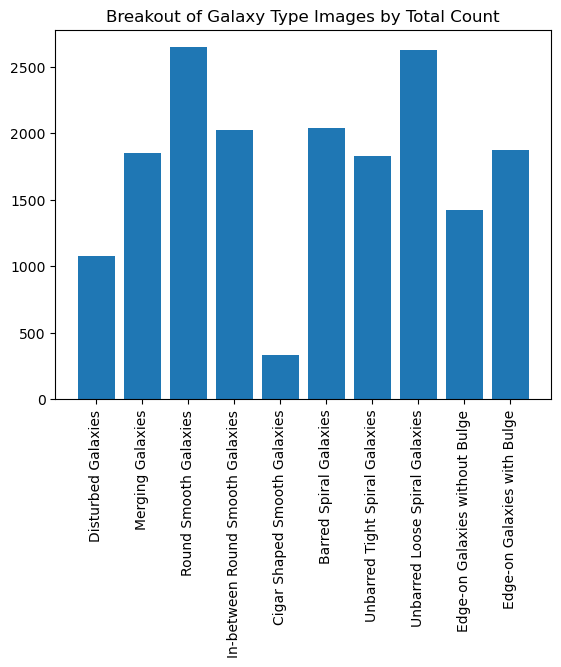

In [14]:
#Printing Basic Counts for each Galaxy Type (Class)
unique_counts = np.unique(labels, return_counts= True)
tot_count = len(labels)

print(f"Total Number of Images: {tot_count}\n")
print(f"Size/Resolution of Images: {images.shape[1]}x{images.shape[2]}x{images.shape[3]} (color channels are g,r,v)\n")
print("Galaxy Types and Counts:")
for num, lab in label_dict.items():
    gcount = len(labels[labels == num])
    print(f"\t {num} -- {lab}:")
    print(f"\t\t -Total Count: {gcount} \n\t\t -% of Total: {round(gcount/tot_count *100, 2)}%")

print()
plt.bar(x = unique_counts[0], height = unique_counts[1])
plt.title("Breakout of Galaxy Type Images by Total Count")
plt.xticks(ticks = unique_counts[0], labels = label_dict.values(), rotation = 90)
plt.plot();

## Preprocessing

In [16]:
## Background Subtraction
def random_sampling_inpaint(image, mask, exclusion_mask):
    "Inpaints using Random Sampling"
    mask = mask.astype(bool)
    exclusion_mask = exclusion_mask.astype(bool)
    
    # get coords
    non_star_coords = np.argwhere(~mask & ~exclusion_mask)
    if len(non_star_coords) == 0:
        return image
    
    # inpaint
    inpainted_image = np.copy(image)
    star_coords = np.argwhere(mask)
    
    for star_coord in star_coords:
        random_choice = non_star_coords[np.random.choice(len(non_star_coords))]
        inpainted_image[tuple(star_coord)] = image[tuple(random_choice)]
        
    return inpainted_image

def background_subtraction(image):
    "Does background subtraction to remove background noise from image"
    # convert to 8-bit and grayscale
    image_8bit = image.astype(np.uint8)
    gray_image = color.rgb2gray(image_8bit)

    # blur and contrast
    blurred = gaussian(gray_image, sigma=2)
    clipped = np.clip(blurred, 0, 1)
    contrast_enhanced = equalize_adapthist(clipped)

    # binary image
    binary_threshold = threshold_otsu(contrast_enhanced)
    lowered_threshold = binary_threshold * 0.8  
    binary_image = contrast_enhanced > lowered_threshold

    # clean and label
    cleaned_binary_image = binary_closing(binary_image, square(3))
    cleaned_binary_image = binary_dilation(cleaned_binary_image, square(1))
    labeled_image = label(cleaned_binary_image)

    # find the central blob
    regions = regionprops(labeled_image)
    center_x, center_y = np.array(labeled_image.shape) // 2
    central_region = (center_x - 10, center_y - 10, center_x + 10, center_y + 10)

    for region in regions:
        minr, minc, maxr, maxc = region.bbox
        if (minr < central_region[2] and maxr > central_region[0] and
            minc < central_region[3] and maxc > central_region[1]):
            central_blob = region
            break

    # create mask and dilate
    inpainting_mask = np.zeros_like(gray_image, dtype=bool)
    for region in regions:
        if region.label != central_blob.label:
            inpainting_mask[labeled_image == region.label] = True
    inpainting_mask = binary_dilation(inpainting_mask, disk(3))

    # create an exclusion mask for the central blob
    exclusion_mask = np.zeros_like(gray_image, dtype=bool)
    minr, minc, maxr, maxc = central_blob.bbox
    exclusion_mask[minr:maxr, minc:maxc] = True

    # apply inpainting
    image_inpainted = random_sampling_inpaint(image_8bit, inpainting_mask, exclusion_mask) if np.any(inpainting_mask) else image_8bit

    return image_inpainted

In [20]:
np.unique(labels, return_counts = True)

(array([0., 1., 2., 3., 4., 5., 6., 7., 8., 9.], dtype=float32),
 array([1081, 1853, 2645, 2027,  334, 2043, 1829, 2628, 1423, 1873]))

## Test Train Split 

### Undersampled Test Train split to avoid Kernel Crashing

In [17]:
u_images = []
u_labels = []
for clss in np.unique(labels):
    inds= np.argwhere(labels == clss)[:334].flatten()
    u_labels.append(labels[inds])
    u_images.append(images[inds])
u_images = np.array(u_images).reshape([3340, images[0].shape[0], images[0].shape[1], 3])
u_labels = np.array(u_labels).reshape(3340)

In [18]:
for image in enumerate(u_images):
    u_images[image[0]] = background_subtraction(image[1])

In [19]:
X_train, X_test, y_train, y_test = train_test_split(u_images, 
                                                    u_labels, 
                                                    stratify = u_labels, 
                                                    train_size = .8, 
                                                    test_size = .2, 
                                                    random_state = 1243) 


In [20]:
u_images = 0
u_labels = 0

## Example Images

Examples of Galaxy Images: 




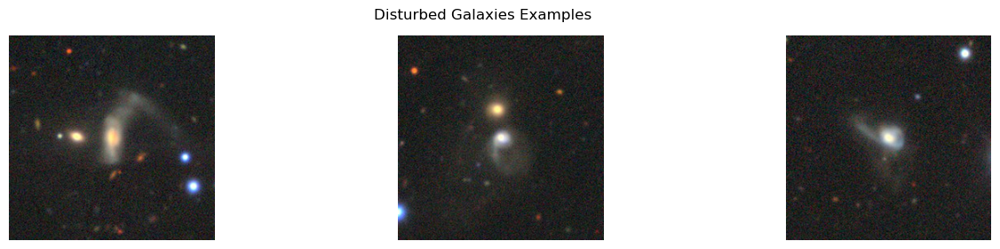

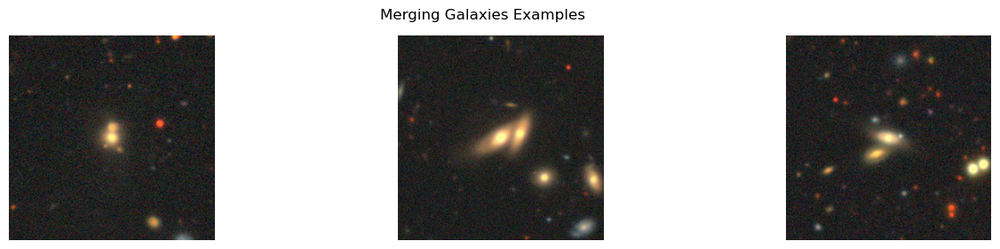

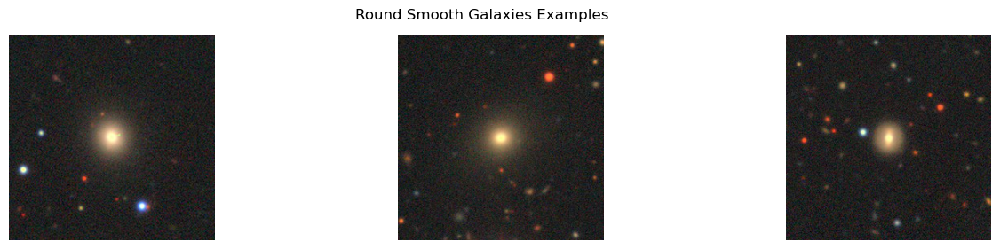

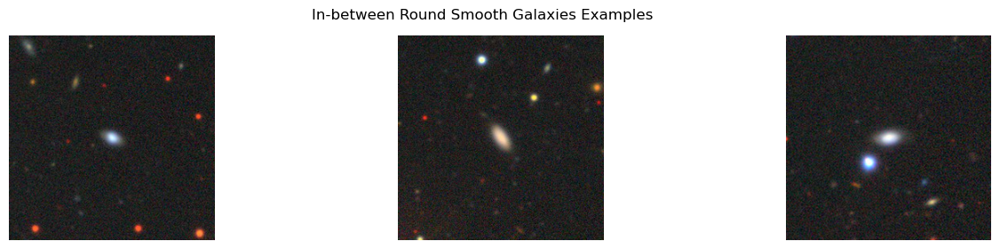

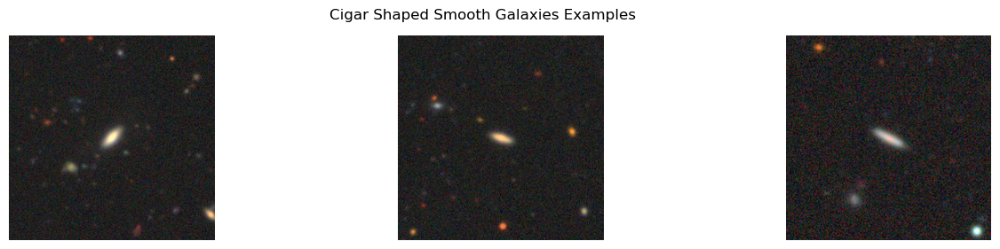

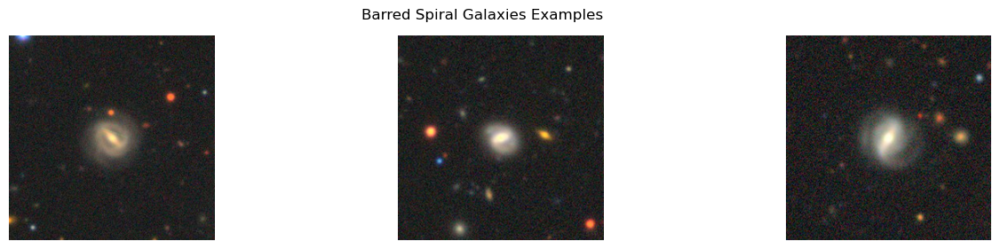

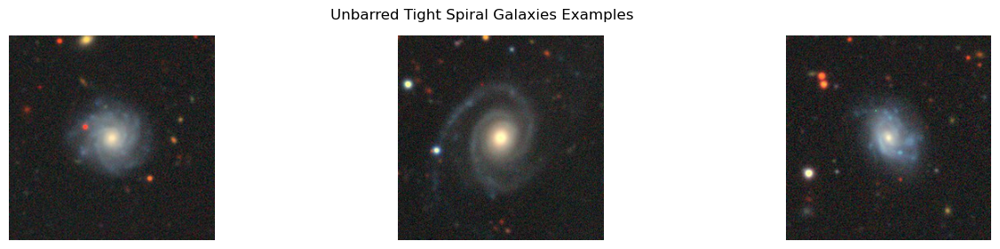

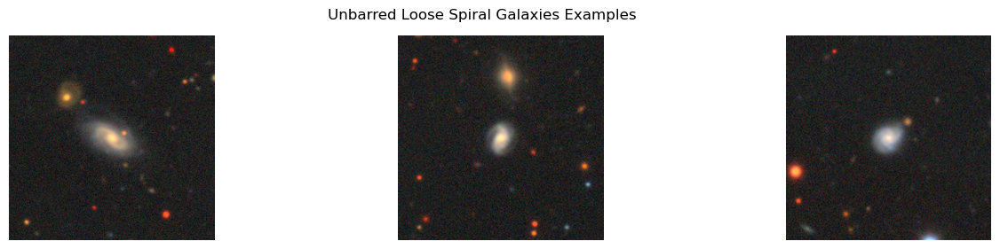

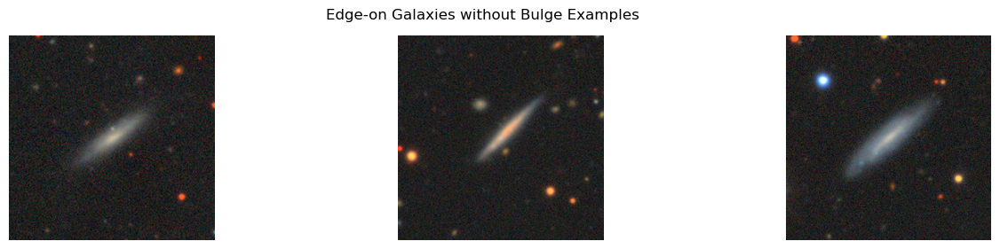

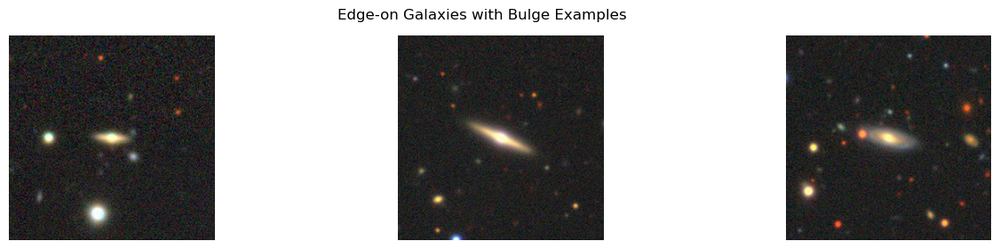

In [63]:
print("Examples of Galaxy Images: \n\n")
ind = []
for clss in label_dict.keys():
    inds = np.argwhere(labels ==  clss)[:3]
    ind.append(inds)
    plot_galaxy(images[inds][:,0], f"{label_dict[clss]} Examples")

Examples of Galaxy Images After Preprocessing: 




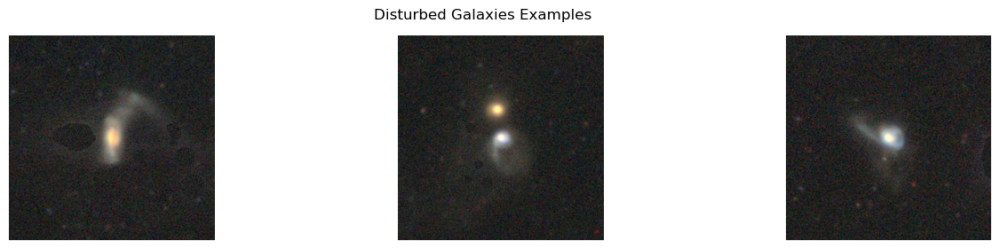

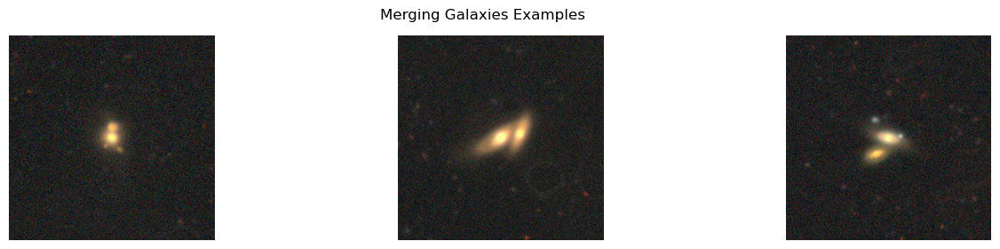

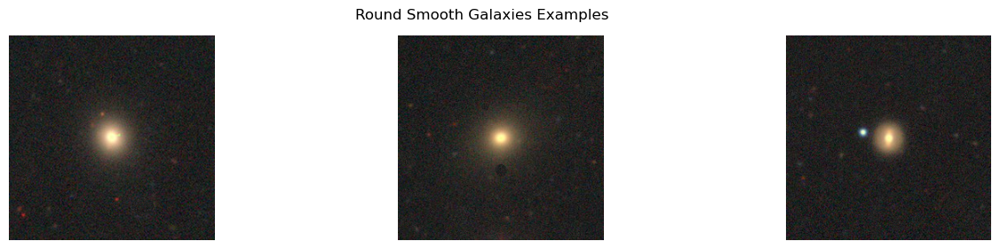

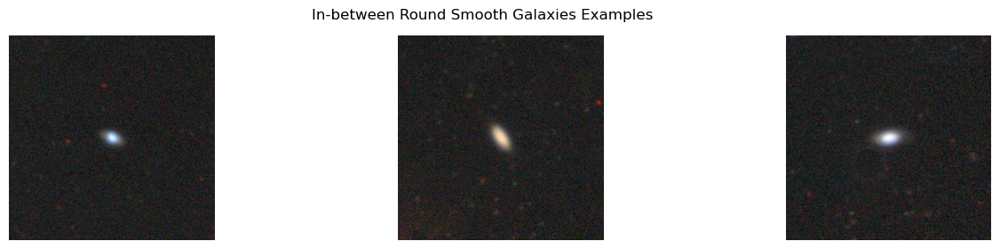

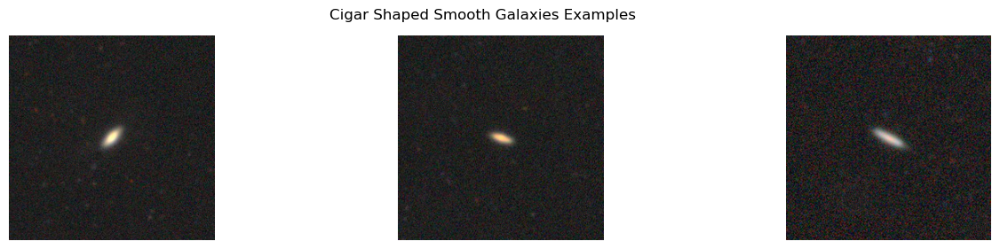

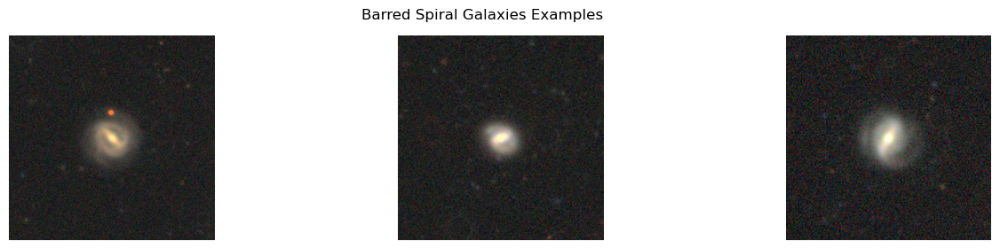

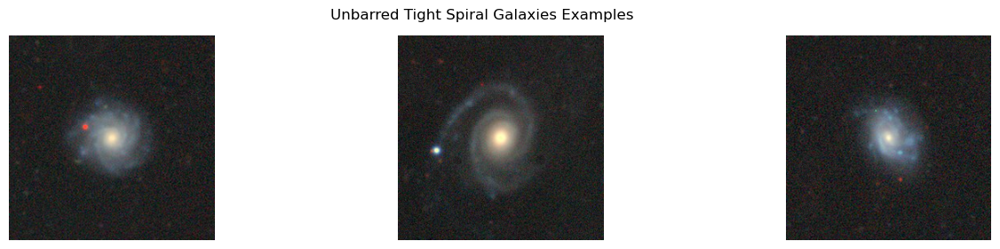

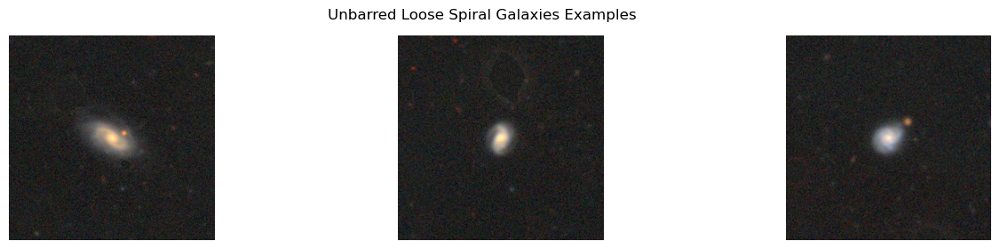

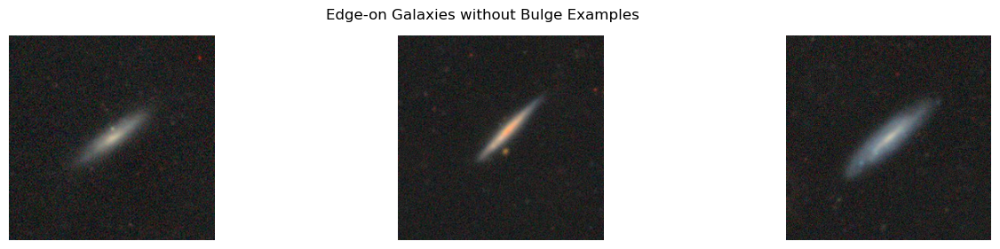

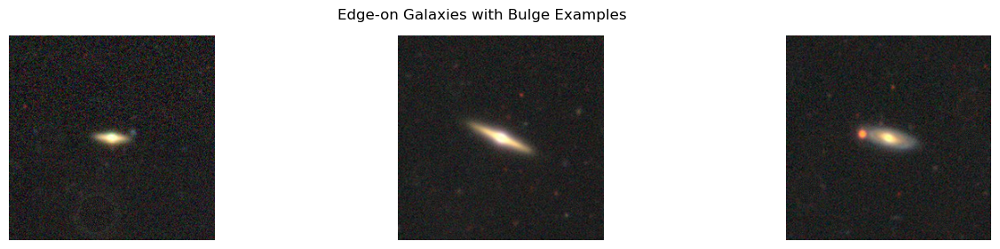

In [62]:
print("Examples of Galaxy Images After Preprocessing: \n\n")
    
for clss in label_dict.keys():
    our_ims = np.array(images[ind[clss]]).reshape(-1, 256, 256, 3)
    for image in enumerate(our_ims):
        our_ims[image[0]] = background_subtraction(image[1])
    plot_galaxy(our_ims, f"{label_dict[clss]} Examples")

### Example Grayscale Images

Examples of Grayscale Galaxy Images: 




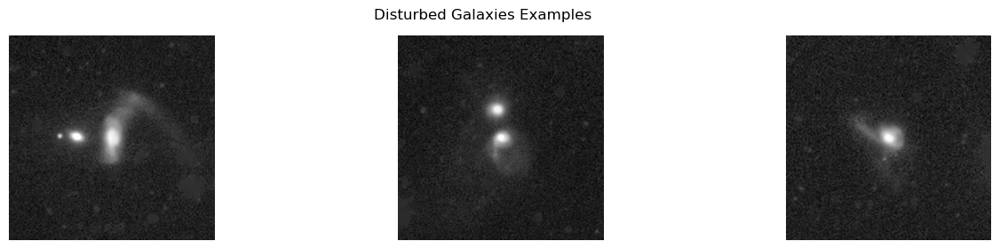

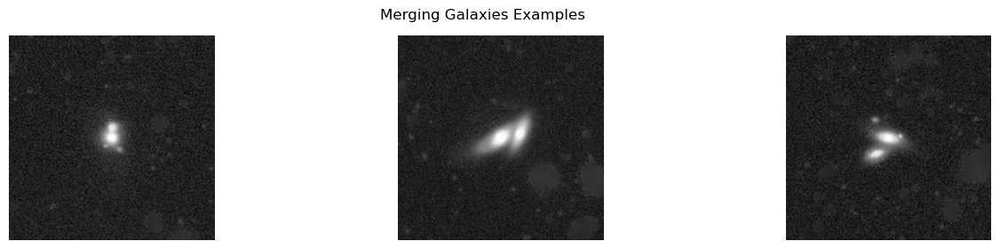

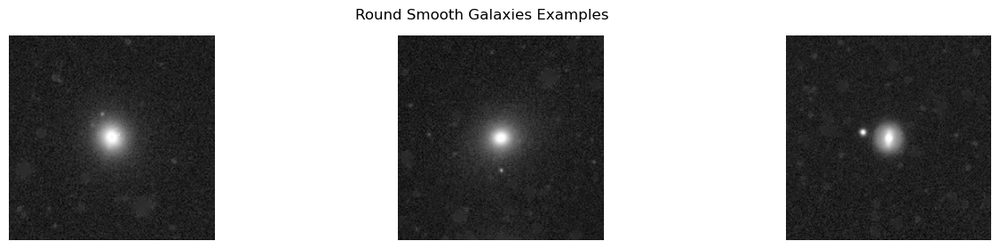

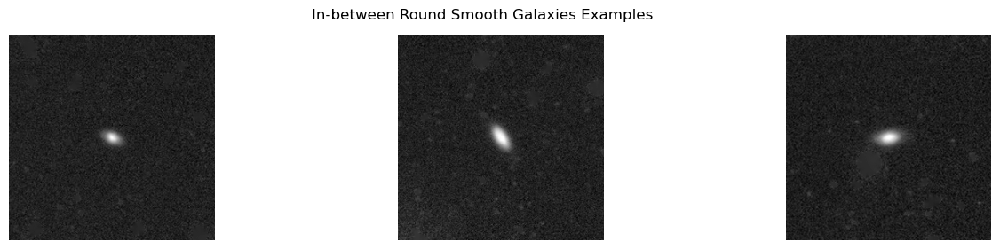

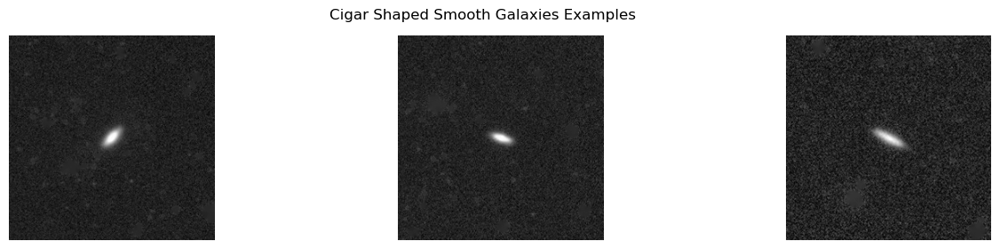

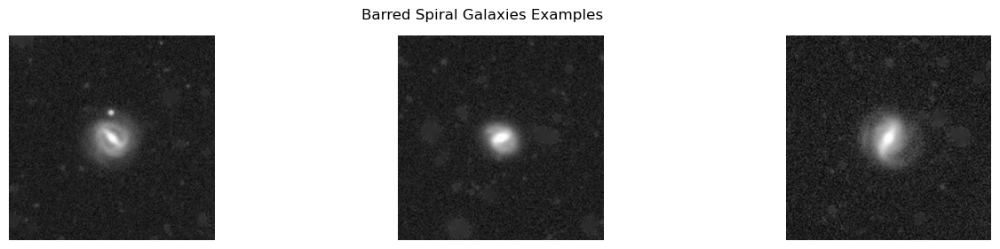

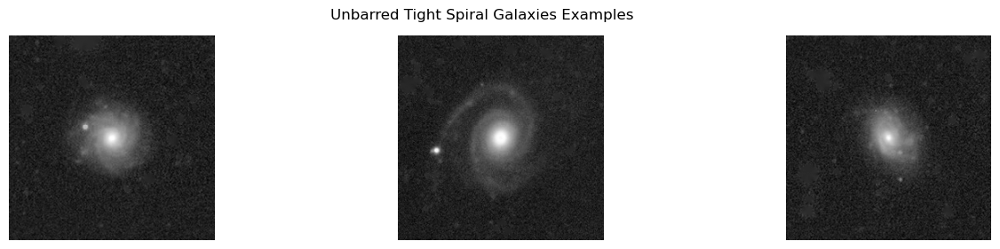

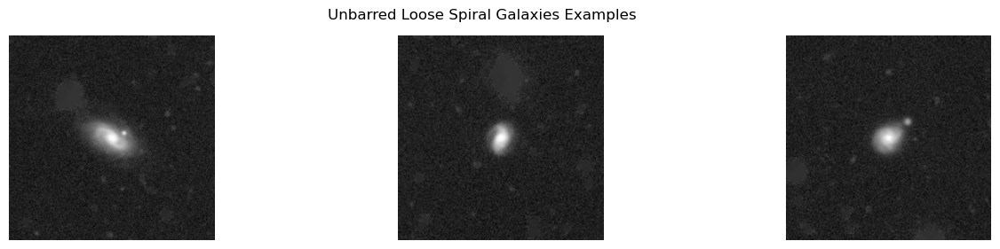

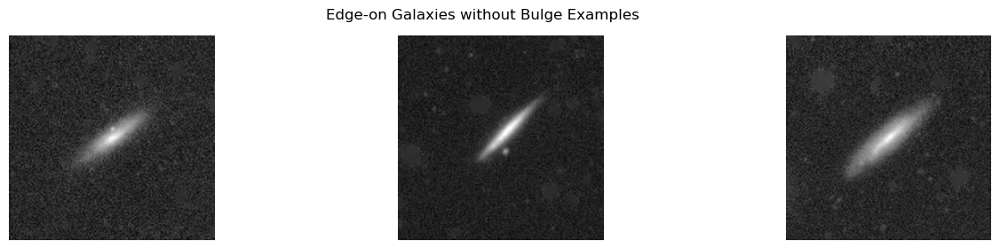

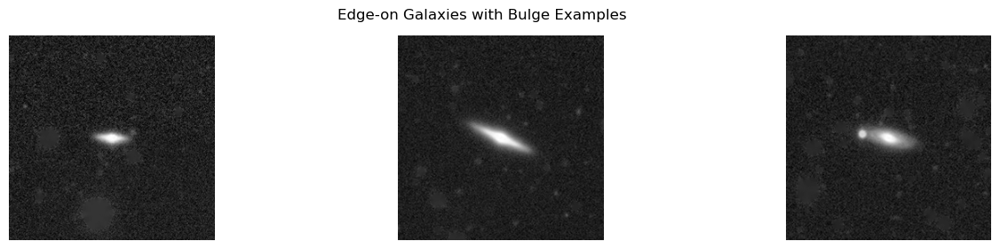

In [22]:
print("Examples of Grayscale Galaxy Images: \n\n")
for clss in label_dict.keys():
    inds = np.argwhere(labels == clss)[:3]
    plot_galaxy_bw(convert_gray(images[inds][:, 0]), f"{label_dict[clss]} Examples")

## Feature Analysis/Extraction

### Laplacian Stacks

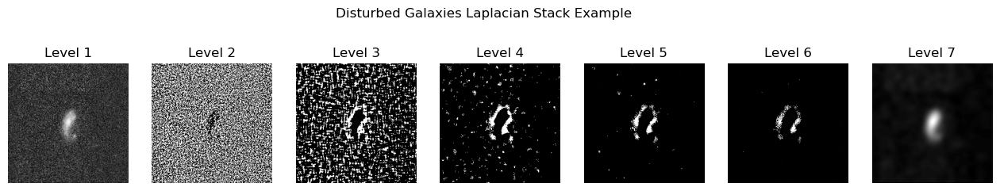

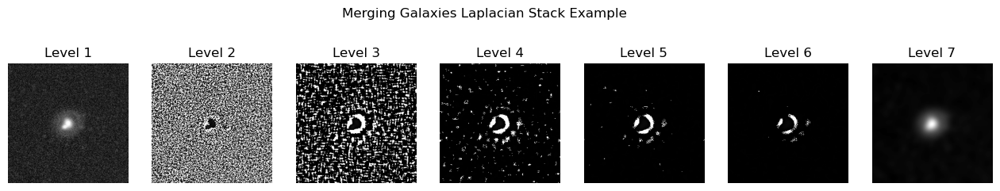

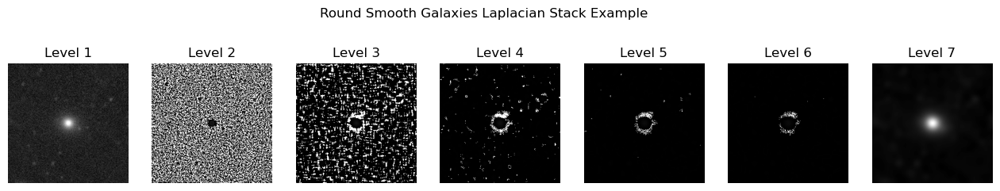

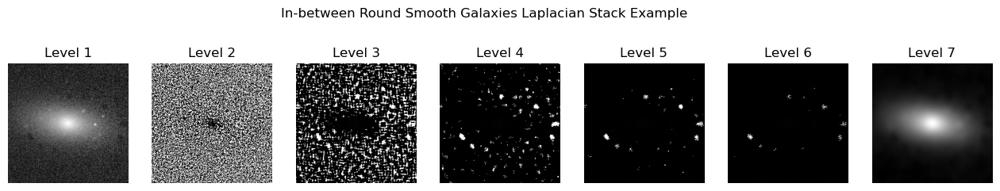

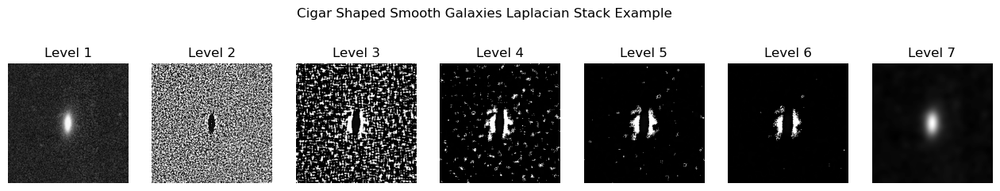

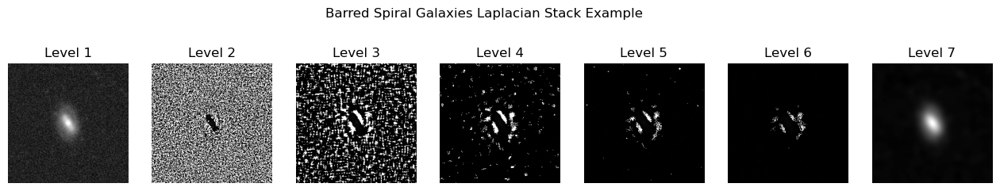

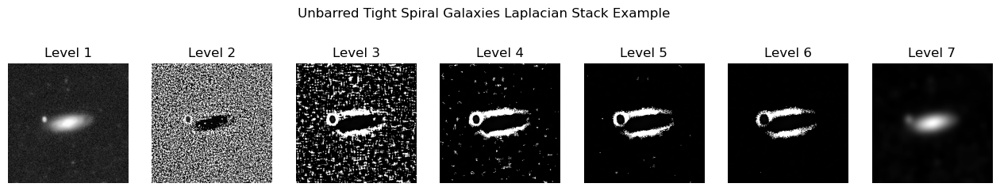

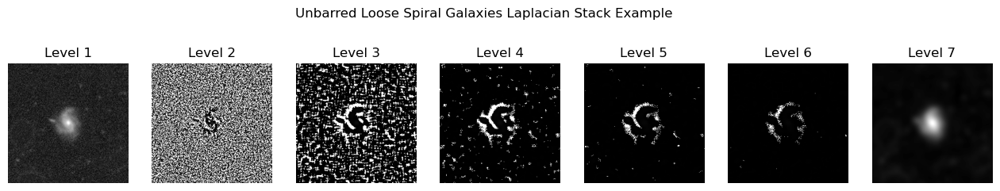

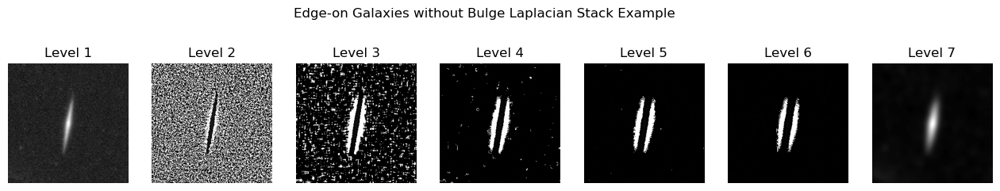

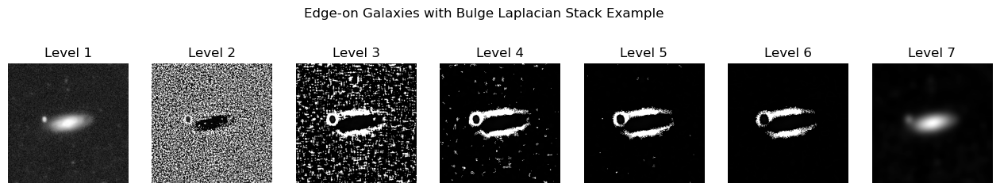

In [65]:
for clss in label_dict.keys():
    inds = np.argwhere(y_train ==  clss)[:1]
    lps = np.array([laplacian_stack(convert_gray([i])[0], 6) for i in X_train[inds][:,0]])
    #lps = np.array([laplacian_stack(i[:,:,2], 6) for i in images[inds][:,0]])
    img_num = 1
    for lp in lps:
        visualize_stack(lp, f'{label_dict[clss]} Laplacian Stack Example')
        img_num+=1


### Color Channel Extraction (Mean and Center)

In [121]:
images_color_means = extract_mean_colors(X_train)
images_color_centers = extract_center_color(X_train)

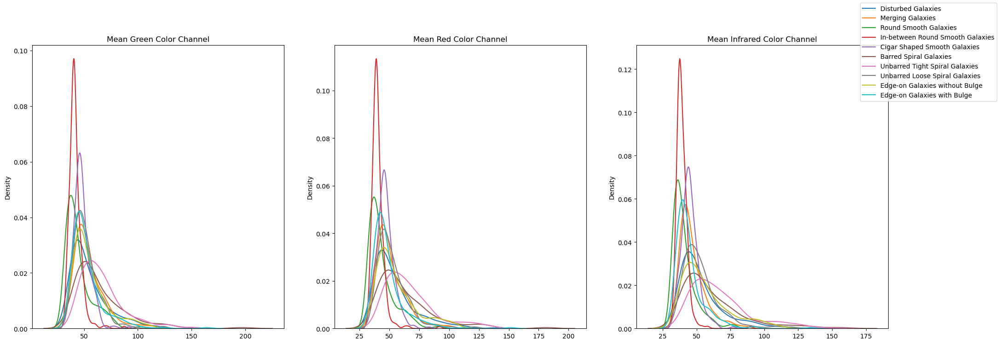

In [122]:
plot_mean_and_center_color_channels(np.array(images_color_means), y_train)

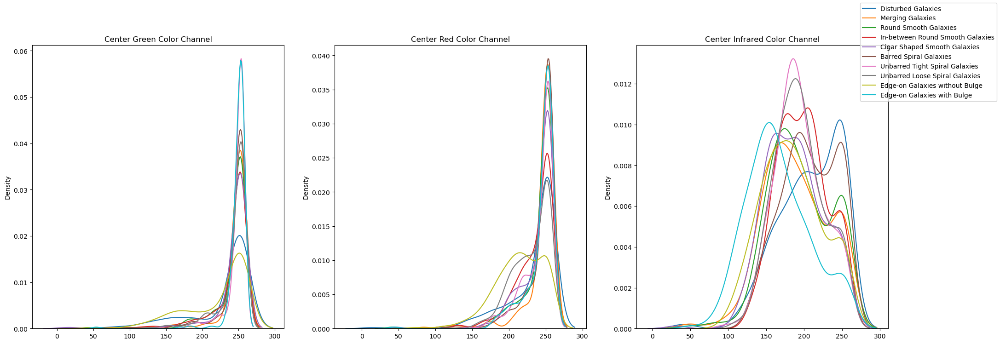

In [123]:
plot_mean_and_center_color_channels(np.array(images_color_centers), y_train, False)

### HOG

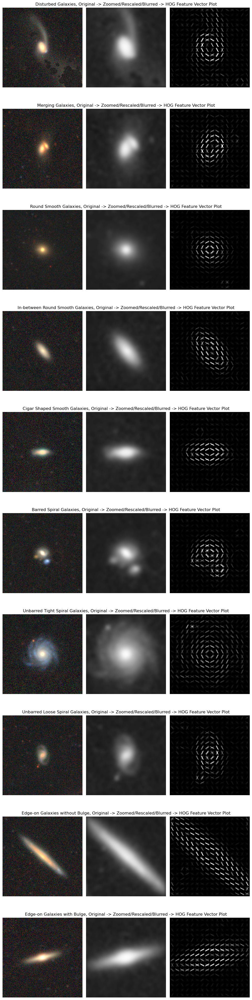

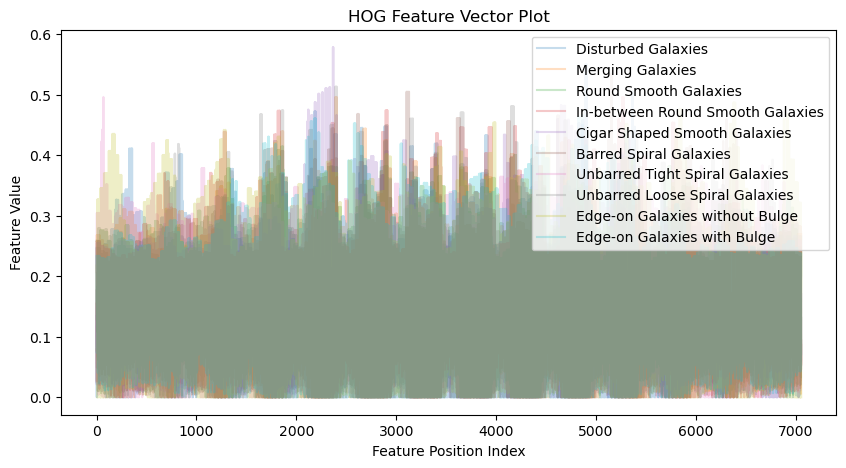

In [50]:
fig, ax = plt.subplots(nrows=len(list(label_dict.keys())), ncols=3, figsize=(10,40))
imgs = []
feats = []
hists = []

for clss in label_dict.keys():
    if clss == 9:
        ind = np.argwhere(y_train== clss)[2]
    else:
        ind = np.argwhere(y_train== clss)[3]
    im = X_train[ind]
    im_processed = rescale_image_bw(convert_gray(im)[0]/255, blur = True)
    imgs.append(im_processed)
    f, h = hog(im_processed, orientations=4, pixels_per_cell=(8, 8), visualize=True)
    feats.append(f)
    hists.append(h)
    ax[clss, 0].imshow(im[0]/255, cmap='gray', vmin=0, vmax=1)
    ax[clss, 0].axis('off')
    ax[clss, 1].imshow(im_processed, cmap='gray', vmin=0, vmax=1)
    ax[clss, 1].axis('off')
    ax[clss, 1].set_title(f'{label_dict[clss]}, Original -> Zoomed/Rescaled/Blurred -> HOG Feature Vector Plot')
    ax[clss, 2].imshow(10*h, cmap='gray', vmin=0, vmax=0.5)
    ax[clss, 2].axis('off')
plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 5))
for f in feats:
    plt.plot(f, alpha=0.25)
plt.title("HOG Feature Vector Plot")
plt.xlabel("Feature Position Index")
plt.ylabel("Feature Value")
plt.legend(['{}'.format(i) for i in list(label_dict.values())])
plt.show()

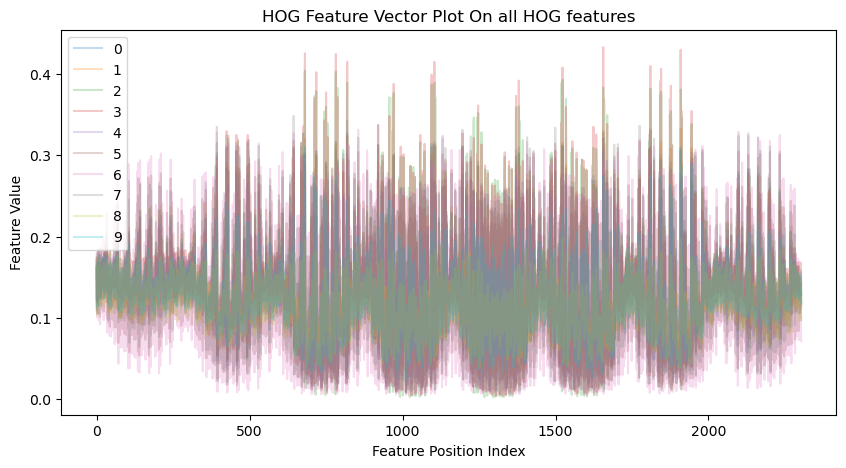

In [168]:
plt.figure(figsize=(10, 5))
train_hog = get_hog_features(convert_gray(X_train))
for clss in list(label_dict.keys()):
    inds = np.argwhere(y_train == clss)
    clss_hog_feats = np.mean(np.array(train_hog)[inds], axis = 0)
    plt.plot(clss_hog_feats[0], alpha=0.25)
plt.title("HOG Feature Vector Plot On all HOG features")
plt.xlabel("Feature Position Index")
plt.ylabel("Feature Value")
plt.legend(['{}'.format(i) for i in list(label_dict.keys())])
plt.show()

### Visual BOW

In [76]:
## Add Visual BOW feature analysis https://www.pinecone.io/learn/series/image-search/bag-of-visual-words/
from sklearn.cluster import KMeans

sift_descriptors = []
sift_kp = []
for im in X_train:
    sift = cv2.SIFT_create()
    keypoints, descriptors = sift.detectAndCompute(convert_gray([im])[0], None)
    if descriptors is None:
        continue
    else:
        descriptors = descriptors[np.random.randint(len(descriptors), size = 25)]
        sift_descriptors.append(descriptors)
        sift_kp.append(keypoints)

    
all_descriptors = np.array(sift_descriptors).reshape(len(sift_descriptors)*25, 128)

k = 200
kmeans = KMeans(n_clusters =  k)
bovw = kmeans.fit(all_descriptors)
histo_list = []


for d in sift_descriptors:
    if d.shape == ():
        continue
    histo_list.append(bovw.predict(d))
    
np.array(histo_list).shape

(2672, 25)

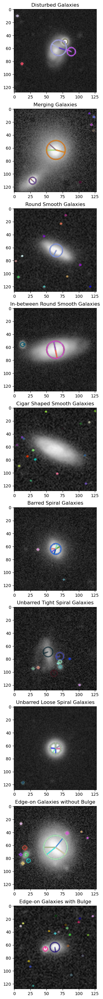

In [77]:
fig, ax = plt.subplots(10, 1, figsize=(24, 42))
classnum = 0
for clss in label_dict.keys():
    cls_center_means = []
    inds = np.argwhere(y_train == clss)[0][0] + 10
    img = rescale_image_cc(X_train[inds])
    gray= cv2.cvtColor(img.astype(np.float32),cv2.COLOR_RGB2GRAY).astype('uint8')
    sift = cv2.SIFT_create()
    kp, descriptors = sift.detectAndCompute(gray, None)
    # Marking the keypoint on the image using circles
    img=cv2.drawKeypoints(gray,
                  np.array(kp)[np.random.randint(len(kp), size = 25).reshape(-1)] ,
                  img ,
                  flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

    ax[clss].imshow(img)
    ax[clss].set_title(label_dict[clss])

In [78]:
frequency_vectors = []
for visual_words in histo_list:
    # create a frequency vector for each image
    frequency_vector = np.zeros(k)
    for word in visual_words:
        frequency_vector[word] += 1
    frequency_vectors.append(frequency_vector)
# stack together in numpy array
frequency_vectors = np.stack(frequency_vectors)

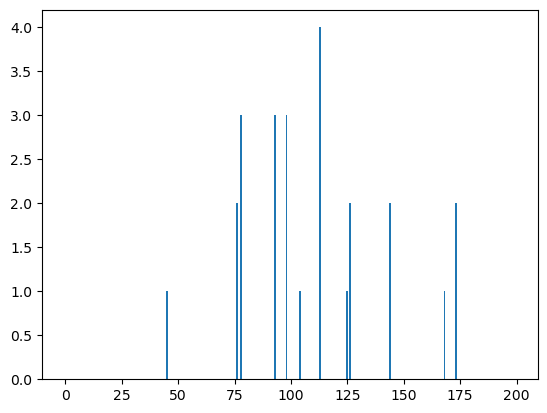

In [79]:
plt.bar(list(range(k)), frequency_vectors[0])
plt.show()

In [80]:
N = len(X_train)

# df is the number of images that a visual word appears in
# we calculate it by counting non-zero values as 1 and summing
df = np.sum(frequency_vectors > 0, axis=0)

In [81]:
idf = np.log(N/ df)
idf.shape, idf[:5]

((200,), array([2.2416083 , 2.35719305, 2.39341431, 2.17684973, 2.41411898]))

In [82]:
tfidf = frequency_vectors * idf
tfidf.shape, tfidf[0][:5]

((2672, 200), array([0., 0., 0., 0., 0.]))

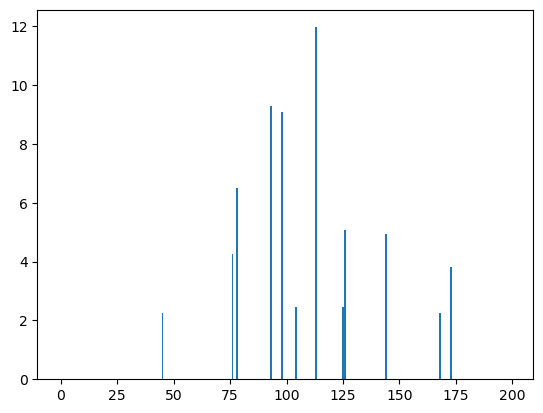

In [83]:
plt.bar(list(range(k)), tfidf[0])
plt.show()

In [84]:
## Generating Codebook for training Set
all_descriptors = visual_bow_kp_descriptors(X_train, desc_size = 25)[2]
codebook = get_bovw_codebook(all_descriptors)

(-1.0, 2.5)

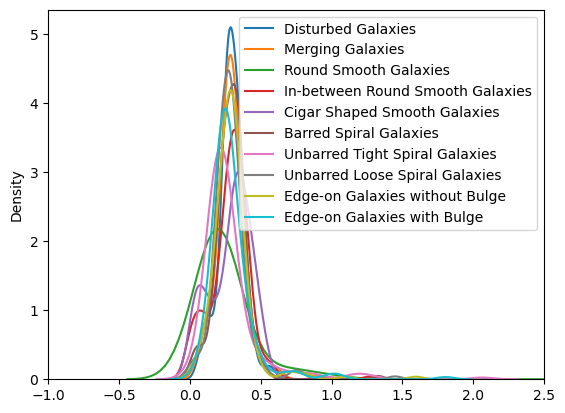

In [85]:
mean_tfidfs =  []
for lab in label_dict.keys():
    inds = np.argwhere(y_train == lab)
    lab_avg = np.mean(tfidf[inds], axis = 0)
    mean_tfidfs.append(lab_avg)
for i in mean_tfidfs:
    sns.kdeplot(data = i[0])
plt.legend(label_dict.values())
plt.xlim(-1,2.5)

### ResNet Embeddings

In [86]:
## Feature Embeddings for resnet

In [87]:
# load the model
resnet101 = models.resnet101(pretrained=True)

/Users/jakepistotnik/opt/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/Users/jakepistotnik/opt/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=ResNet101_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [88]:
model_conv_features = nn.Sequential(*list(resnet101.children())[None:-1]).to('cpu')

In [89]:
# pre-processing required by ResNet
preprocess = transforms.Compose([
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

In [90]:
def prep_ims(imags):
    #gray_ims = convert_gray(images)
    #print(gray_ims)
    return np.array([preprocess(Image.fromarray(im.astype('uint8'))).numpy() for im in imags])

def prep_im(im):
    return preprocess(Image.fromarray(im.astype('uint8')))

In [91]:
# put the model in evaluation mode
resnet101.eval()    

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [92]:
resnet_train_embeddings = np.array([model_conv_features(prep_im(im).unsqueeze(0).to('cpu')).squeeze().detach().numpy() for im in X_train])
resnet_train_embeddings

[W NNPACK.cpp:51] Could not initialize NNPACK! Reason: Unsupported hardware.


array([[1.83120253e-03, 3.81551772e-01, 4.07434881e-01, ...,
        2.48801082e-01, 1.24126312e-03, 3.15785199e-01],
       [4.99366932e-02, 5.27150109e-02, 1.67227294e-02, ...,
        4.15101290e-01, 1.53885502e-03, 2.26380798e-04],
       [1.10551134e-01, 8.60245004e-02, 1.62165597e-01, ...,
        7.53113210e-01, 1.25998510e-02, 6.15856685e-02],
       ...,
       [1.01072378e-02, 5.60960779e-03, 9.12632421e-02, ...,
        4.14901376e-01, 3.55154760e-02, 0.00000000e+00],
       [4.22125496e-03, 6.25858307e-01, 5.82942486e-01, ...,
        4.01188105e-01, 0.00000000e+00, 1.35464044e-02],
       [1.77879054e-02, 4.39565927e-02, 3.74994203e-02, ...,
        3.36156934e-01, 4.18967307e-02, 4.79123835e-03]], dtype=float32)

## Building Feature Matrix For PCA plots

In [24]:
train_feats, feature_labels = get_features(X_train)

/Users/jakepistotnik/opt/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/Users/jakepistotnik/opt/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=ResNet101_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
[W NNPACK.cpp:51] Could not initialize NNPACK! Reason: Unsupported hardware.


## PCA

In [136]:
def feature_PCA(feature_vectors, num_components = None):
    pca_list = []
    transformed_features = []
    components_dict = {'Mean Color Channel': 3,'Center Color Channel': 3, 'HOG': 315, 'BOVW':190, "Resnet":150}
    for i in range(len(feature_vectors)):
        if num_components == None:
            pca_ = PCA(n_components = list(components_dict.values())[i])
        else:
            pca_ = PCA(n_components = num_components)
        fit_pca = pca_.fit(feature_vectors[i])
        transformed_vect = fit_pca.transform(feature_vectors[i])
        pca_list.append(fit_pca)
        transformed_features.append(transformed_vect)
    return pca_list, transformed_features
    
def plot_PCA(pca_list, colors, feature_names):
    plt.figure(figsize=(15,5))
    for i in range(len(pca_list)):
        color = colors[i]
        name = feature_names[i]
        cumu = np.cumsum(pca_list[i].explained_variance_ratio_)*100
        plt.plot(cumu, color = color, label = name)
        plt.axvline(x=np.argmax(cumu>95), color=color, linestyle="--")
    plt.title('Cumulative Explained Variance explained by component')
    plt.ylabel('Cumulative Explained variance (%)')
    plt.xlabel('Principal components')
    #plt.xticks(np.arange(num_components)+1)
    #plt.yticks(np.linspace(0, 1, 8))
    plt.axhline(y=95, color="r", linestyle="--")
    plt.legend()
    plt.show()

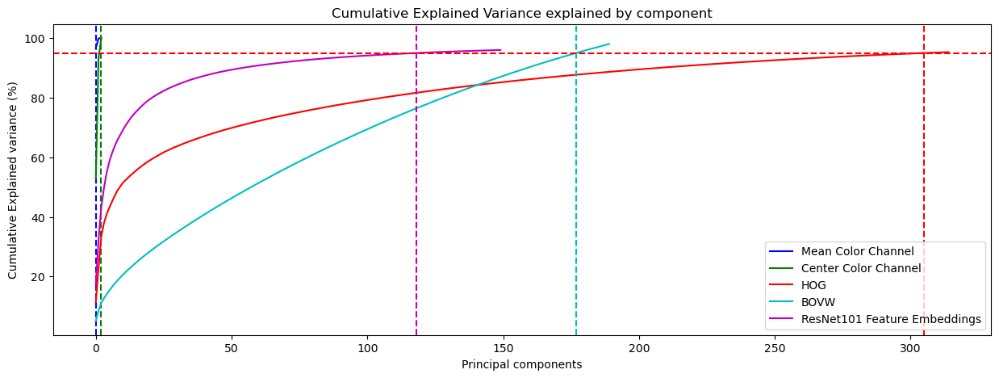

In [137]:
x = feature_PCA(train_feats)
plot_PCA(x[0], ['b','g', 'r', 'c', 'm'], feature_labels)

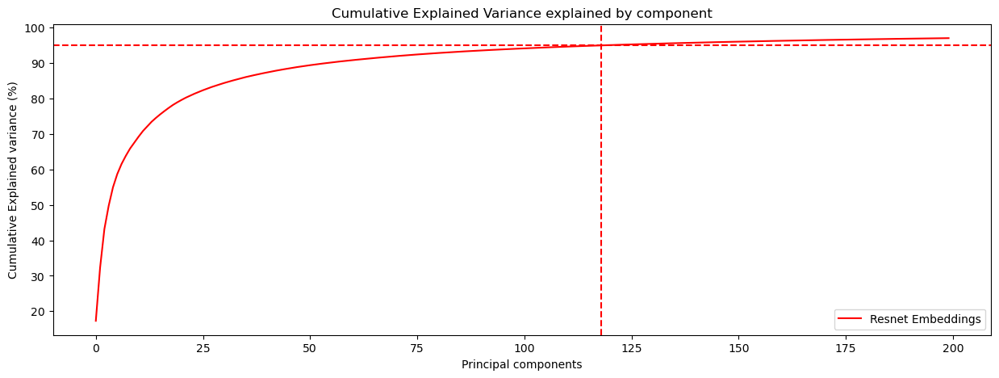

In [168]:
x = feature_PCA([resnet_train_embeddings], num_components = 200)
plot_PCA(x[0], ['r'], ['Resnet Embeddings'])

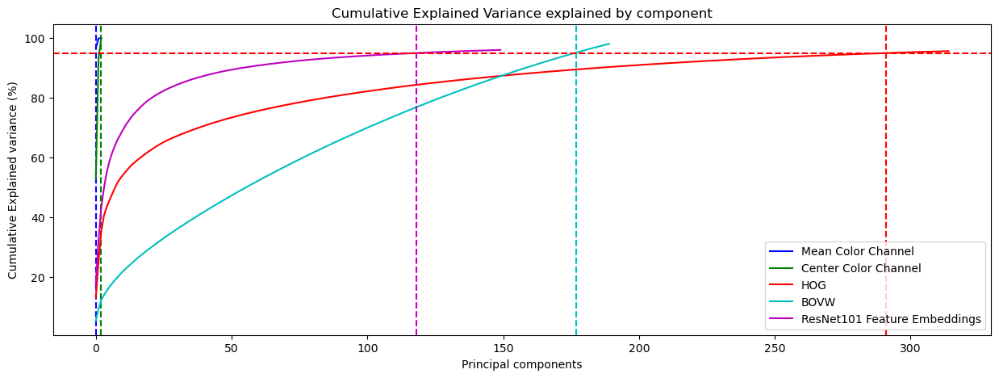

In [136]:
x = feature_PCA(train_feats)[0]
plot_PCA(x, ['b','g', 'r', 'c', 'm'], feature_labels)

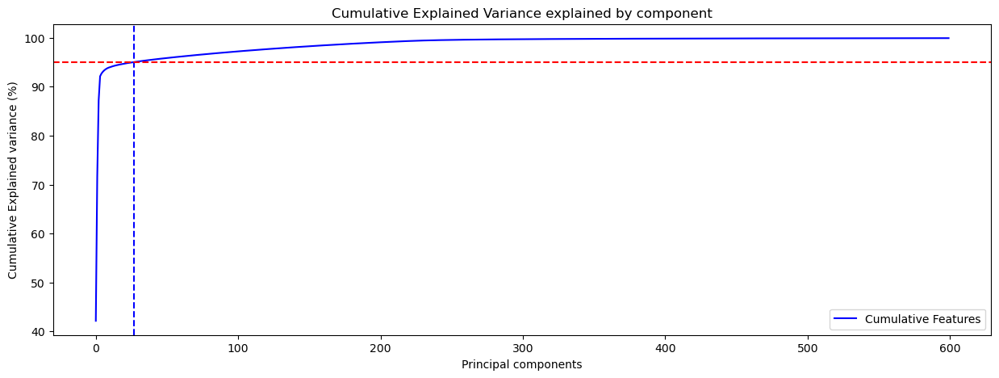

In [137]:
x = feature_PCA([np.concatenate(train_feats, axis = -1)], num_components = 600)
plot_PCA(x[0], ['b'], ['Cumulative Features'])

In [138]:
np.cumsum(x[0][0].explained_variance_ratio_)[:30]*100

array([42.16959366, 71.60608864, 87.22233571, 92.12391139, 92.70117465,
       93.07195845, 93.35989163, 93.58278536, 93.75804546, 93.89168539,
       93.99391779, 94.09190477, 94.1843914 , 94.26693167, 94.34171288,
       94.41081451, 94.47568092, 94.53807675, 94.59549399, 94.65116342,
       94.70608086, 94.76024435, 94.81046096, 94.85724126, 94.90354941,
       94.94849758, 94.99256188, 95.0363906 , 95.07809575, 95.11967232])

## tSNE

In [166]:
def get_tsne(X_list, n_components=200):
    xtsne_list = []
    for X in X_list:
        tsne = TSNE(n_components=n_components, random_state=1243, perplexity = 5)
        X_tsne = tsne.fit_transform(X)
        xtsne_list.append(X_tsne)
    return xtsne_list

In [130]:
from sklearn.manifold import TSNE

In [138]:
tnses = get_tsne(x[1], 2)

/Users/jakepistotnik/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/jakepistotnik/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
/Users/jakepistotnik/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/jakepistotnik/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
/Users/jakepistotnik/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2

In [139]:
def plot_classes(X, y, ax, title):

    # color code each cluster (person ID)
    colormap = plt.cm.tab20
    colorst = [colormap(i) for i in np.linspace(0, 1.0, len(np.unique(y)))]

    # project the features into 2 dimensions
    for k in range(len(np.unique(y))):
        ax.scatter(X[y==k, 0], X[y==k, 1], alpha=0.5, facecolors=colorst[k])

        ax.set_title(title)

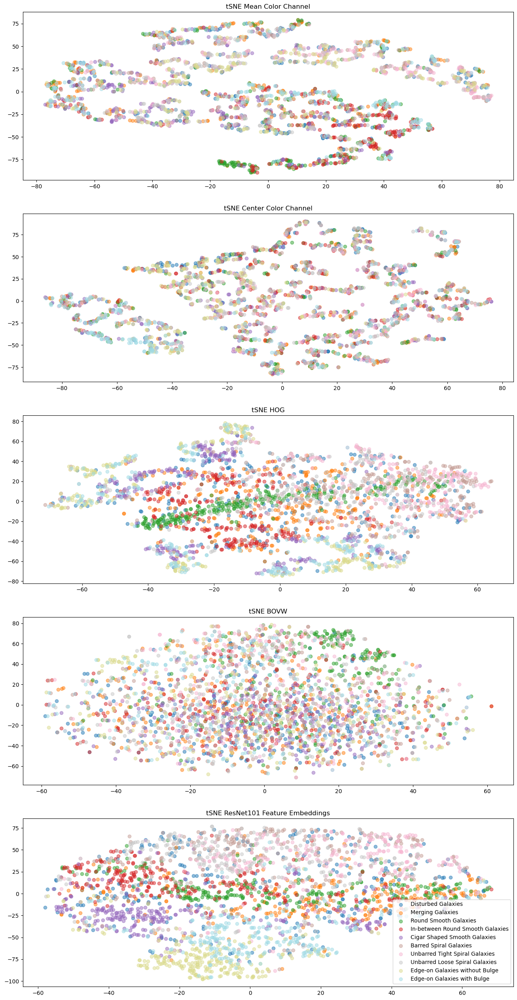

In [165]:
fig, ax = plt.subplots(5,1,figsize = (16,32))
for i in (range(5)):
    plot_classes(tnses[i], y_train, ax[i], f'tSNE {feature_labels[i]}')
plt.legend(label_dict.values())

In [156]:
cum_tnses = get_tsne([np.concatenate(x[1], axis = -1)], 2)

/Users/jakepistotnik/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/jakepistotnik/opt/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


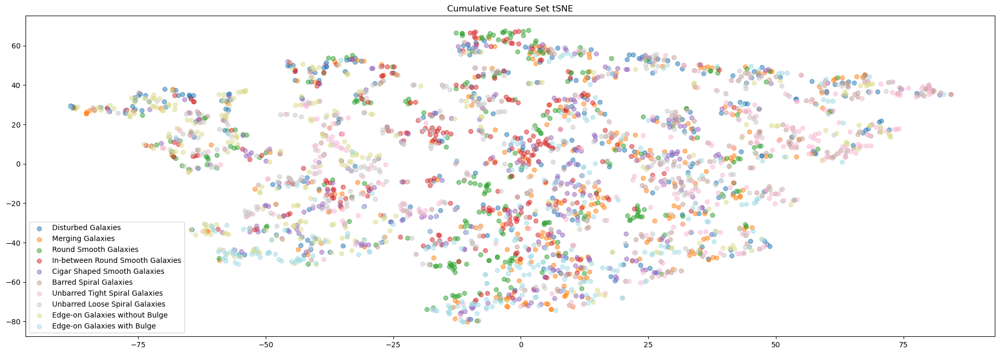

In [167]:
fig, ax = plt.subplots(1,1,figsize = (24,8))
plot_classes(cum_tnses[0], y_train, ax, 'Cumulative Feature Set tSNE')
plt.legend(label_dict.values())

661